During the revision stage, this repository is only meant for reviewers to view. After acceptance of the article, a DOI will be generated for each appropriate dataset where they will be permanently stored, and the data will be moved from here to different repositories. Accordingly, do not distribute any of the data contained herein. 

# Supplementary Notebook for "Three-Dimensional Paganica Fault Morphology Obtained from Hypocenter Clustering (L’Aquila 2009 seismic sequence, central Italy)" 


This Jupyter Notebook combines both the writing and high level code to improve reproducibility of the work. You can view the notebook in nbviewer with interactive figures. You can also run the Notebook in the cloud using Binder. If you are already reading this from nbviewer, simply click on the Binder link to open your own cloud computing environment. 

Three-Dimensional Paganica Fault Morphology Obtained from Hypocenter Clustering (L’Aquila 2009 seismic sequence, central Italy)![image.png]

Brennan Brunsvik<sup>1,2</sup>, Gabriele Morra<sup>1,3</sup>, Gabriele Cambiotti<sup>4</sup>,
Lauro Chiaraluce<sup>5</sup>, Raffaele Di Stefano<sup>5</sup>, Pasquale De Gori<sup>5</sup>, David
A. Yuen<sup>6,7</sup>

\(1) School of Geosciences, University of Louisiana at Lafayette, LA
70504, USA.

\(2) Department of Earth Science, University of California Santa Barbara,
CA 93106, USA.

\(3)  Department of Physics, University of Louisiana at Lafayette, LA
70504, USA.

\(4)  Department of Earth Sciences, University of Milan, Via Cicognara 7,
20133 Milano, Italy.

\(5)  Istituto Nazionale di Geofisica e Vulcanologia, Via di Vigna
Murata, 605 001s43 Rome, Italy

\(6) Dept. of Earth Sciences and Minnesota Supercomputing Institute,
University of Minnesota, Minneapolis, MN 55455, USA

\(7)  Dept. of Applied Physics and Applied Mathematics, Columbia
University, New York, NY 10026, USA

**Corresponding author:** Brennan Brunsvik;
<brennan.brunsvik@gmail.com>; 40 S. Patterson Ave 204, Santa Barbara,
CA, 93111

**Keywords:** fault morphology, clustering, L’Aquila earthquake sequence

**Highlights:**

- Machine learning can be used for retrieving the 3D morphology of faults quickly and objectively. 
- We apply clustering to L’Aquila sequence aftershock hypocenters to distinguish which faults they occurred on. 
- We use the clustered hypocenters to invert for the 3D morphology of the Paganica fault system. 

**Declarations of interest:** none

**Funding:** This research did not receive any specific grant from
funding agencies in the public, commercial, or not-for-profit sectors.

Abstract 
========

In seismic modelling, fault planes are normally assumed to be flat due to the lack of data which can constrain fault morphology. However, incorporating 3D fault morphology is important for modelling several phenomena, for example calculating mainshock induced stress changes. We utilize a data-analytical method to unveil the 3D rupture morphology of faults using unsupervised clustering techniques applied to earthquake hypocenters in seismic sequences. We apply this method to the 2009 L’Aquila seismic sequence which involved a MW 6.1 mainshock on April 6th. We use a dataset of about 50,000 relocated events, mostly microearthquakes, reaching magnitude of completeness equal to 0.7. Clustering distinguishes the earthquakes as occurring in three main clusters along with other minor fault segments. We then represent the morphology of the main Paganica fault system (responsible for the largest mainshock) using splines. This method shows promise as a step toward robustly and quickly obtaining 3D rupture morphologies where earthquake sequences have been monitored. The 3D model is presented interactively online, and the processing is presented in an interactive Jupyter Notebook. 

1 Introduction 
============
The 3D morphology of fault planes is generally unknown at depth due to the lack of information which can constrain them. We present an approach where we use machine learning to find the 3D morphology of faults based on the spatial distribution of aftershocks in seismic sequences. We apply this method to model the Paganica fault system which was the source of the April 6th, 2009 MW 6.1 mainshock of the thoroughly monitored L'Aquila seismic sequence in the central Apennines, Italy (Scognamiglio et al., 2010). 

This approach to automating the inversion of 3D fault morphology can be useful in many ways. Inaccuracies in fault morphology can interfere with earthquake source inversions, resulting in less realistic slip distributions (Ragon et al., 2018) and affecting coulomb stress calculations and aftershock forecasts (Kaven and pollard, 2013; Mildon et al., 2016; Verdecchia et al., 2018; Mancini et al., 2019). In addition, the morphology of faults influences dynamic stress (e.g. Pelties et al., 2012; Galvez et al., 2014; Zhang et al., 2014), earthquake magnitude and location (Barka et al., 1988; Zielke et al., 2017), tsunami generation (Moore et al., 2007), and other phenomena. Along megathrusts (e.g. the MW 7.8 2015 Gorkha earthquake, Hubbard et al., 2016) the determination of the 3D morphology of slabs and faults has been taken into account (Qiu et al., 2016; Landry and Barbot, 2018). This can provide information on locked zones (Avouac, 2008; Avouac et al., 2015), which are crucial to understand as they can promote intense seismicity. For the major subduction zones of the Earth, it has been shown that curvature influences earthquake rupture area and magnitude (Bletery et al., 2016). Ultimately, progress toward automatic and objective fault reconstruction is an important task in seismology. 

A variety of methods are used to estimate fault morphology. Active source seismology is used to build high resolution fault models (e.g. Lohr et al., 2008; Røe et al., 2014). This is the case, among others, of the low angle Altotiberina normal fault in the northern Apennines (Italy) for which 3D morphology was obtained by merging seismic imaging, borehole analysis, geologic maps, and field surveys. Unfortunately, the costs of active source seismology and drilling make this a difficult option. Fault geometry can also be illuminated from passive source methods. For example, modelling of seismic waves trapped in low-velocity damage zones can provide information on fault geometry (Peng et al., 2003; Ben-Zion et al., 2003; Calderoni et al., 2012). 

The distribution of foreshocks and aftershocks can also provide information on fault morphology. Analysts can attribute earthquakes to their source faults by visual inspection of earthquake locations and surfaces can be fit to the aftershocks to model these faults (e.g. Carena et al., 2002). The combination of hypocenter interpretation along with various other data types (e.g. fault traces, borehole data, geodetic data, geologic cross-sections) has been used to construct 3D geologic models of faults associated with the L’Aquila sequence (Lavecchia et al., 2012; Lavecchia et al., 2017; Castaldo et al., 2018) and the 2016 Amatrice/Visso/Norcia sequence (Lavecchia et al., 2016; Tung and Masterlark, 2018). While these methods are successful, they involve qualitative and subjective elements which influence the results based on the analysts’ background. Moreover, it is not quickly reproducible, particularly in quasi real-time as a seismic sequence evolves.

On the argument of automation and fast, reproducible data analysis, machine learning is becoming increasingly useful in Earth science (Kong et al., 2019; Bergen et al., 2019). Some examples include determining earthquake magnitudes (Mousavi and Beroza, 2019), analyzing lab quakes (Rouet-Leduc et al., 2017), and picking phase arrivals (Zhu and Beroza, 2019). Machine learning includes supervised learning which requires pre-labeled data for training, and unsupervised learning where no pre-labeled data is required for training. Clustering is one application of unsupervised machine learning. If data points are distributed in distinct groups, clustering finds these groups and labels each datum according to which group it belongs to (e.g. Omran et al., 2007; Joshi and Kaur, 2013). 

There have been several applications of clustering in Earth Science. For example, it has been applied to earthquake relocation (Trugman and Shearer, 2017), investigation of earthquake processes and precursors (Dzwinel et al., 2003; Dzwinel et al., 2005; Yuen et al., 2009), and distinguishing dominant faulting patterns in focal mechanism data-sets (Rietbrock et al., 1996; Custódio et al., 2016). Hypocenter locations have been clustered to establish seismic zones for probabilistic seismic hazard analysis (Weatherill and Burton, 2009; Ansari et al., 2015; Novianti et al., 2017; Hall et al., 2018; Scitovski, 2018). 

Clustering has also been used to investigate fault geometry based on hypocenter information (Ouillon et al., 2008; Ouillon and Sornette, 2011; Wang et al., 2013). In these cases, clusters were distinguished by fitting them with a series of planes. The RANdom SAmple Consensus (RANSAC) algorithm, which fits a model to the dominant trend in data while attempting to reject outlier data (Fischler and Bolles, 1981), has also been used to find faults in hypocenter data and to model them with 3D surfaces (Kaven and Pollard, 2013; Skoumal, 2019). Ultimately, clustering has the capability to automatically identify groups of hypocenters common to fault zones to aid in inverting fault morphology in a quick and objective fashion.  

Here, we present an approach based on the unsupervised machine learning technique clustering which can automate fault identification using hypocenter locations. We apply our clustering-based method to the L’Aquila seismic sequence in the central Apennines (Italy) which was particularly well monitored with over 50,000 high-resolution relocated aftershocks identified throughout 2009 (Valoroso et al., 2013). This large amount of data is well suited for data-driven techniques. Further, the fault morphologies associated with this sequence are relatively simple, making this a good region to test fault morphology inversion algorithms. 

## 1.1 2009 L’Aquila Seismic Sequence

The faults associated with the L’Aquila seismic sequence have been thoroughly studied (Figures 1 and 2; e.g. Lavecchia et al., 2012; Valoroso et al. 2013). The L’Aquila sequence activated a dominantly south-west dipping normal fault system about 50 km long. Aftershocks are broadly associated with the ~N140° striking Paganica fault system, the ~N150° striking Campotosto (Gorzano) fault, and a cluster near the Cittareale village. The mainshock occurred in the Paganica fault system, which is composed of several enechelon faults extending approximately from the SE end of the San Demetrio fault system through the Mt. Stabiata Fault. The Cittareale cluster is composed dominantly of several NW-SE striking and NE dipping faults, as well as a SW dipping fault likely associated with the Montereale fault system. 

Chiaraluce (2012) provided a review of the 2009 L’Aquila sequence (Figure 1), which began in approximately January, 2009. The foreshocks included a MW 4.0 earthquake on March 30th before the April 6th Mw 6.1 NW-SE striking and SW dipping mainshock (Chiaraluce et al., 2011). Southeast of the mainshock, on April 7th, a MW 5.4 aftershock occurred on a ~NE dipping fault with a non dip-slip component (rake of ~58°: see Figure 1 for focal mechanisms of large events) (Scognamiglio et al., 2010; Valoroso et al., 2013). Campotosto fault seismicity included a MW 5.0 event on April 6th and MW 5.0 and 5.2 events on April 9th, which were dominantly dip slip, SE to SSE striking, and SW to WSW dipping (Scognamiglio et al., 2010). These events occurred on the shallower, steeply dipping portion of the listric Campotosto fault which appears kinked at its base where seismicity abruptly changes to low dip (Chiaraluce, 2012).  A MW 4.4 event occurred later on June 22nd, 2009 beneath this kink, on the gently dipping portion of the Campotosto fault with nodal planes showing dip of 88° or 14° (Valoroso et al., 2013). On June 25th, a MW 3.5 (Scognamiglio et al., 2010) earthquake occurred within the Cittareale cluster. This seismic cluster is approximately the northward extent of the L’Aquila sequence. 

Varying terminology has been used to describe the fault system that we focus on. Many refer to the fault as the “L’Aquila fault system” (e.g. Chiaraluce et al., 2013), and many others use variations on the “Mt. Stabiata – Paganica – San Demetrio fault system” (e.g. Boncio et al., 2010; Lavecchia et al., 2012). The mainshock occurred on the L’Aquila normal fault system, most precisely on the portion corresponding in the field to the Paganica fault (Chiaraluce et al., 2012). Essentially the Mt. Stabiata, Mt. Castellano, Colle Enzano, Paganica, and San Demetrio faults can be viewed as part of the same semi-continuous fault system (Figure 1; Civico et al., 2017). However, it must be recognized that the relationship between outcropping faults and hypocenters can be complex (e.g. Tondi, 2000), and our goal is to more generally model the morphology of the fault zone where it was either coseismically activated by the mainshock or is continuous with the coseismically activated portion of the fault zone. For this reason, and to emphasize the relation of the modelled fault to the mainshock, we call the system the “Paganica fault system” to emphasize the importance of the mainshock. 

In [1]:
# THIS CELL CHOOSES HOW TO RUN THE NOTEBOOK. THE OTHER CELLS CAN BE BASICALLY LEFT ALONE.

runAllFigures = True
savePlotlyFigures = False

# For loading saved values. 
variable_folder = "stored_variables/"
slip_dist_folder = 'slip_dist/'

In [2]:
# Import plotly stuff
from plotly.offline import plot
import plotly.graph_objs as go
import PIL.Image # required for some image manipulation
from IPython.display import clear_output# required for some image manipulation
from plotly.offline import download_plotlyjs, init_notebook_mode
init_notebook_mode(connected=True)

#Import builtin
import os
import sys
import time
from datetime import datetime, date, time
import copy
import json

#sci and num py
import numpy as np
import scipy.optimize as optimize
from scipy.optimize import least_squares
from scipy.interpolate import Rbf
from scipy import interpolate
import scipy
import scipy.io as sio
from numpy.linalg import norm
from numpy.linalg import inv

import pandas as pd
    
## visualization
# matplotlib
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.patches import Ellipse
import matplotlib.patches as patches
from matplotlib.ticker import AutoMinorLocator
import matplotlib.mlab as mlab
import matplotlib
from mpl_toolkits.mplot3d import Axes3D
from scipy.spatial import ConvexHull
import matplotlib.path as mpltPath
from matplotlib.patches import FancyArrowPatch
from mpl_toolkits.mplot3d import proj3d
from matplotlib.colors import ListedColormap 



from scipy.spatial import Delaunay
import matplotlib.cm as cm
from functools import reduce

from IPython.display import Image
##

# For clustering
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler
import sklearn.mixture
import multiprocessing #!# may not need multiprocessing
import sklearn

# pyproj handles UTM projection
import pyproj

In [3]:
# load some other notebooks

# Functions for loading data. 
%run ./Load_Data.ipynb

# Get functions that are used for many mathematical calculations. Open that file for details. 
%run ./Calculation_Functions.ipynb

# Functions for fault splitting 
%run ./Fault_Splitting.ipynb #!# remove this

# Get some fundamental functions for making figures. Open that file for details. 
%run ./Figure_Making_Functions.ipynb

# Get clustering info
%run ./clustering_base_file.ipynb

# Get some stress related stuff
%run ./stress_base_file.ipynb 
# ! This shouldn't be needed, 01/04/2019

%run ./plots3d.ipynb

Figure 1. Map view of seismicity of the L'Aquila seismic sequence.
Hypocenters are from Valoroso et al. (2013). Fault traces and surface
ruptures are modified from Boncio et al. (2010) and Valoroso et al.
(2013). Focal mechanisms are plotted for events with M \>= 5 in addition
to the M~W~ 3.9 event in the Cittareale area.

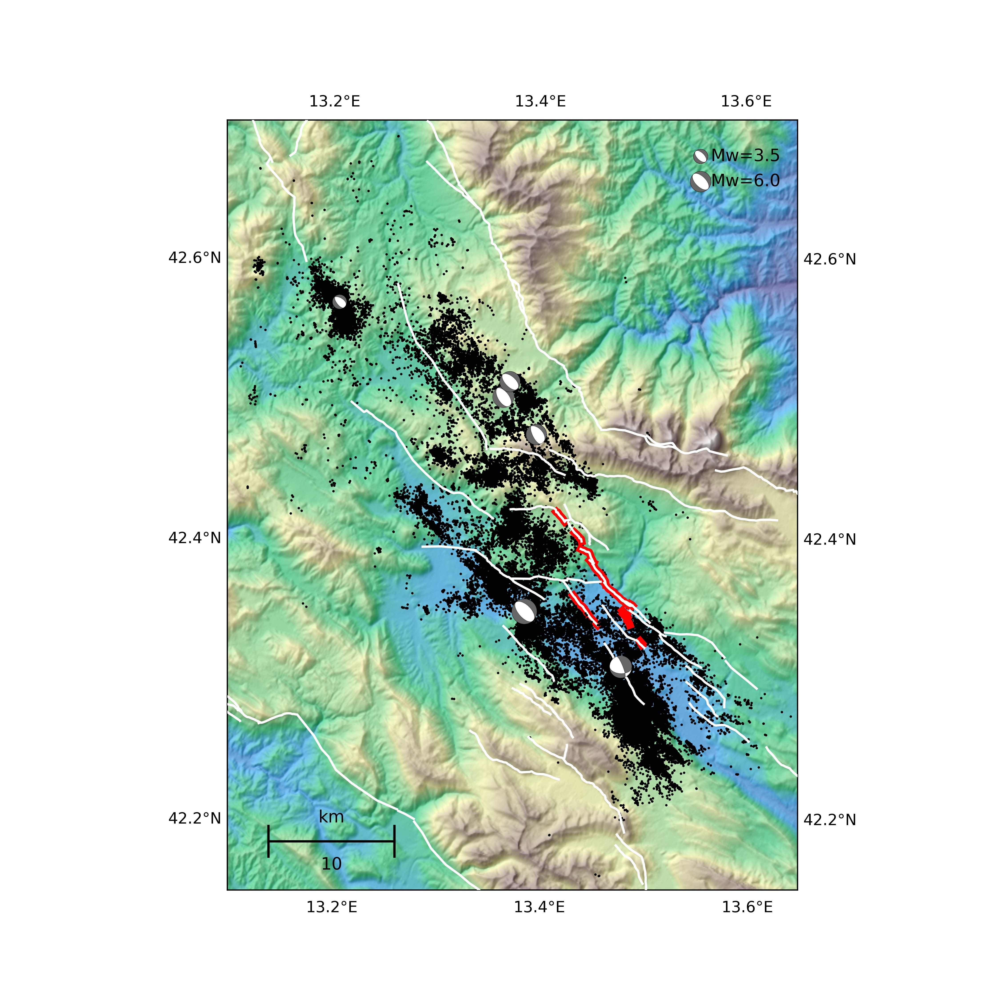

In [4]:
Image(filename='figures/map.jpg') 

Figure 2. Simplified schematic of the fault system involved in the
L'Aquila sequence. Seismic activity occurred dominantly on the L'Aquila,
Campotosto, and Cittareale faults. The Paganica fault hosted the
mainshock. The faults strike approximately NW-SE and dip SW.

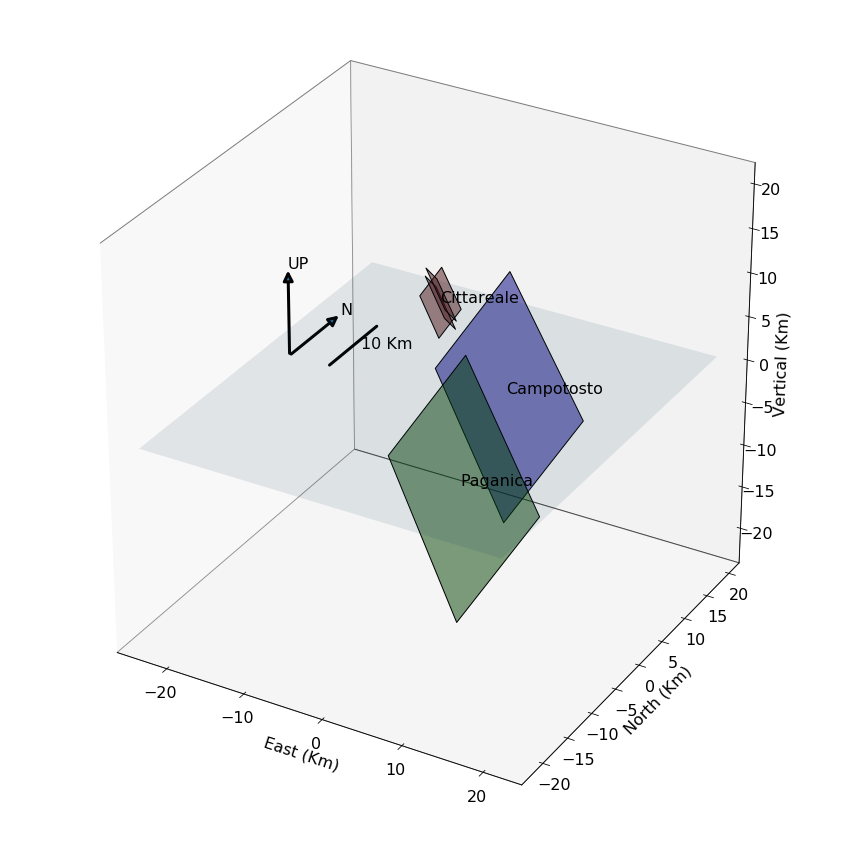

In [5]:
make_schematic_plot()


2 Methods 
==========

The aim of the method we propose is to use aftershock locations to
invert for fault morphology in an objective, completely automated way.
To this aim it is prerequisite to group aftershocks according to the
faults they occurred on. Then we can invert for the 3D morphology of a
specific group of aftershocks using splines (Jones et al., 2014).

The first step is to apply clustering to the hypocenters to distinguish
between different faults throughout the seismic sequence. We run two
iterations of clustering, one with spectral clustering, and another with
Density-Based Spatial Clustering of Applications with Noise (DBSCAN), to
increase the quality of the results. Finally, after clusters of
hypocenters are categorized according to their source faults, we focus
on specifically the Paganica fault, and we interpolate a continuous 3D
surface for this fault.

We use the earthquake catalog of Valoroso et al. (2013). The catalog was
generated by applying STA/LTA event detection, applying an automated
phase arrival picking procedure, removing duplicate events,
cross-correlating records of event pairs, and finally applying the
double-difference relocation algorithm *hypoDD* (Waldhauser and
Ellsworth, 2000). Based on 95% confidence intervals obtained from a
bootstrap analysis, the authors estimated mean location errors of 0.087,
0.178, and 0.039 km in the vertical and two horizontal directions,
respectively.

To isolate different faults through hypocenter data, we use the machine
learning clustering technique applied to earthquakes relative positions
in 3D, similar to Ouillon et al. (2008). The machine learning clustering
approach attempts to find relationships in data based on their
similarity. In our case, where the locations of different earthquakes
are sufficiently close, clustering can recognize that these earthquakes
occurred on the same fault. If the earthquakes are sufficiently distant
from each other, clustering can recognize that the earthquakes occurred
on different faults.

Several challenges will arise using this approach. Where faults
intersect, hypocenters of different faults can be very close to each
other and clustering algorithms can be blind to this. Further,
aftershock location inaccuracy is inevitably present due to imperfect
knowledge of crustal 3D velocities and elastic properties. Thus,
hypocenters tend to erroneously appear between multiple faults, and to
which fault these hypocenters belong to is unclear. To mitigate this,
clustering is done in two iterations; first with a spectral method, and
second with DBSCAN.

During the first clustering iteration, we used the spectral clustering
algorithm of Scikit-Learn (Pedregosa et al., 2011). Von Luxburg (2007)
provided an overview of spectral clustering. Spectral clustering is
appropriate because it works well for non-convex clusters (a cluster is
non-convex when a line drawn between two points can escape the cluster,
such as hypocenters belonging to a curved fault). We first compute the
similarity matrix between points:
$\mathbf{s}_{\mathbf{i,j}} = \exp( - {\parallel \mathbf{x}_{\mathbf{i}} - \mathbf{x}_{\mathbf{j}} \parallel}^{2}/2\sigma^{2})$,
where $\mathbf{x}_{\mathbf{i}}$ and $\mathbf{x}_{\mathbf{j}}\ $ are the
positions of the *i*th and *j*th hypocenters, and $\sigma$ is the width
of the gaussian kernel. Then, the normalized Laplacian matrix is
constructed: $\mathbf{L}\, = \,\mathbf{D}\, - \,\mathbf{W}$.
$\mathbf{W}$ is the weighted adjacency matrix of each point. We use
$\mathbf{W} = \mathbf{S}$. The degree matrix $\mathbf{D}$ is a diagonal
matrix containing the degrees of the weight vector
$d_{i} = \Sigma_{j = 1}^{n}w_{i,j}$. Then, the first $k$ eigenvectors
$\mathbf{u}_{\mathbf{1}},\ldots,\mathbf{u}_{\mathbf{k}}$ of $\mathbf{L}$
are computed to construct $\mathbf{U} \in R^{n \times k}$. Finally, in
$k$-dimensional space, the $n$ points within $\mathbf{U}$ are assigned
labels using $k$-means.

For the spectral clustering application, we used only the 542
earthquakes with M~L~ \>= 2.3 (Table 1). This helps to remove small
aftershocks that blur the distinction between different faults. It also
makes the memory demanding spectral clustering algorithm more stable and
manageable. Spectral clustering, like many other clustering algorithms,
requires prior knowledge of the number of clusters. We choose $k = 3$,
corresponding to the Paganica, Campotosto, and Cittareale faults (Table
1). Note that this choice of $k = 3$ only applies to the spectral
clustering step: the number of clusters found during our later
application of DBSCAN will be independent. Finally, we choose
$\sigma = 2000$ m (Table 1). However, for
$1250\ \mathrm{m} < \sigma < \ 4300\ \mathrm{m}$, the results vary only
negligibly. This spectral clustering step separated the hypocenters into
three dominant clusters (Figure S1).

Figure S1. This shows the results of spectral clustering. The Paganica fault is green, the Campotosto blue, and Cittareale red. 

In [6]:
# object with info for all hypocenters. 
allHypo = hypoData(minMag=None)

allHypo.labels=np.zeros(allHypo.mL.size)

if False:
    allHypo.plot3dclusters(pointSize=1, save=False)

In [7]:
   
# Spectral clustering
sp = spClust()
sp.minMag=2.3
sp.getHypocenters()

sp.assign_labels="kmeans"
sp.n_init=50
sp.n_clusters=3 # choose this based on the 3 main faults
sp.sigma = 2000

sp.cluster()
# spectral clustering is completed 
# sp.labels indicates cluster identities
if True:
    sys.path.append('geo_data')
    from importlib import reload

    fig2 = plot3dclusters(sp.x, sp.y, sp.z, sp.labels, 
                   sp.latCent, sp.lonCent, color_option = 1, 
                   faulttraces3d=True)
    
    def save_3d(fig2, name):
        sc1 = 1.3
        sc2 = 1. 
        sc3 = .8
        sc4 = .5
        layouts = [
                  {'x':1.3*sc2, 'y':-.6*sc2, 'z':.8*sc2},
                  ]
        for i in range(len(layouts)):
    #         if i != 3:
    #             continue
            layout = fig2.layout
            layout['scene']['camera']['eye'] = layouts[i]
    #             layout['scene']['camera']['center'] = {'x':4400, 'y':-222, 'z':-3322}
            fig2.update({'layout':layout})
            fig2.write_image('figures/' + name + '_' + str(i+1) + '.jpg', scale = 7)
            im = PIL.Image.open('figures/' + name + '_' + str(i+1) + '.jpg')
        return im      
    
    if False or savePlotlyFigures:
        im = save_3d(fig2, 's1')

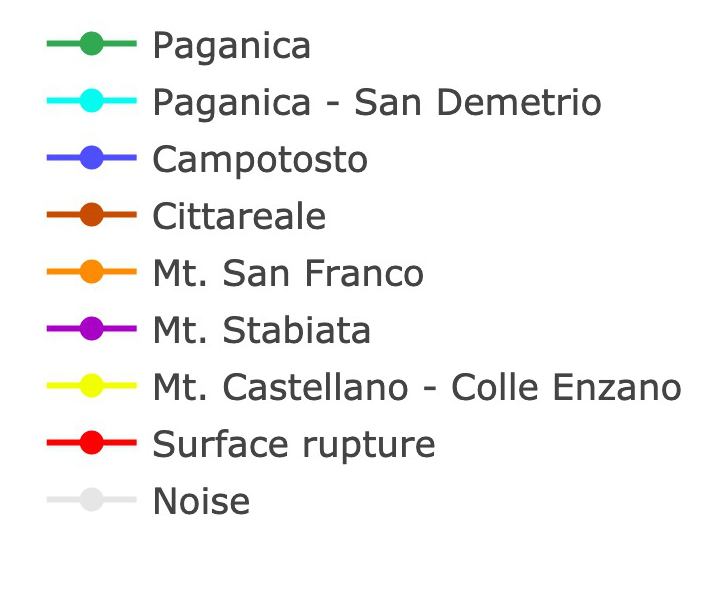

In [8]:
add_legend_plotly()



Before applying the second clustering iteration, we modify the
hypocenter data to enhance fault like trends. Using the 396 hypocenters
which were preliminarily identified as corresponding to the Paganica
fault using spectral clustering, we solve for a least squares distance
best fit plane. The positions of all 51339 hypocenters, which includes
those outside of the Paganica fault cluster, were then stretched by a
factor $f = 5$ in the direction normal to the best fit plane (Table 1).
$f$ is chosen with the purpose to enhance planar trends in the
hypocenters, especially those matching the Paganica fault's strike and
dip. This preliminary operation on data minimally influences hypocenters
close to the fault surface identified by the best fit plane, while
deviations of earthquakes far from this surface are amplified. With
these planar trends more pronounced and bias from deviant earthquakes
reduced, clustering algorithms are much more successful at clustering
along faults and keeping them separate from neighboring faults. This
step also reduces the problem that some hypocenter groups may lie along
the same fault, but there are so few hypocenters between these groups
that clustering algorithms normally find them as separate clusters. This
spatial modification also allows for the use of less computationally
expensive clustering methods.

Our pending results for the Paganica fault can be closely matched
without applying $\text{f\ }$given careful tuning of other clustering
parameters (Figure S2). However, without applying $f,$ we observe that
clustering will be less successful when considered over the entire
seismic sequence. For example, for $f = 1$, we find no combination of
DBSCAN parameters which will work for the Paganica fault and are
simultaneously capable of distinguishing the Campotosto fault from the
Mt. San Franco fault. For $f > 5$, we do not observe further improvement
to clustering.

We then applied DBSCAN (Ester et al., 1996; Pedregosa et al., 2011;
Schubert et al., 2017) on the modified dataset. Intuitively, DBSCAN
finds dense clusters of points which are separated by regions of low
point density. DBSCAN relies on the distinction of core points, border
points, and noise. A point *p* is considered a core point if there are
*\>* MinPts points *q* with dist(*p,q*) *\<* Eps. Such points *q* are
considered direct density-reachable from *p* and are part of the same
cluster. A point *q* that does not qualify as a core point, but with
dist(*p,q*) *\<* Eps, is considered a border point in the same cluster
as the core point *p*. A point *p~n\ ~*is density reachable from each
core point *p~j\ ~*in the series *p*~1~*,p*~2~*\...p~n\ ~*if *p~i~*~+1~
is direct density-reachable from *p~i\ ~*for 1 *\< i \< n*−1. Note that
*p~n\ ~*itself can be either a core point or border point. This allows
for the growth of clusters by density reachability where all
density-reachable points from the core point *p* are part of the same
cluster. A point *q* with dist(*p~j~,q*) *\>* Eps to all core points
*p~j\ ~*is considered noise. Thus, a cluster is composed of core points
*p* and their density reachable border points *q*. We empirically found
that Eps = 2 km and MinPts = 80 (Table 1) are a good choice for the
Paganica fault, though, based on a grid search of Eps and MinPts, the
DBSCAN clustering results for this fault are only negligibly sensitive
to Eps and MinPts (Figure S3).

Figure 3. Also available interactively online at
<https://bit.ly/3i1epZu>. Final results from clustering hypocenters from
the L'Aquila seismic sequence. Spectral clustering was first used to
find three primary clusters. DBSCAN was then used on all hypocenter
location data. The gray dots were considered by DBSCAN to be noise. Four
hypocenter clusters are colored according to potentially affiliated
geological fault traces: the Paganica fault, Campotosto fault,
Cittareale fault, and Mt. San Franco fault. Other clusters were found
for which we do not consider their relationship to known fault
outcroppings, and these are colored randomly.

In [9]:
# Make a best fit plane to the cluster containing the mainshock
laqFault = sp.labels == sp.labels[np.argsort(sp.mL)[-1]] # new 2020.07.27

x = sp.x[laqFault]
y = sp.y[laqFault]
z = sp.z[laqFault]
mL = sp.mL[laqFault]
strikeHyp = sp.st1[laqFault]
dipHyp = sp.dp1[laqFault]
strike2Hyp = sp.st2[laqFault]
dip2Hyp = sp.dp2[laqFault]

focalBool = (~( (sp.st1==0) * (sp.st2==0) * (sp.dp1==0)
               * (sp.dp2==0) * (sp.rk1==0) * (sp.rk2==0) ))[laqFault]

splineNodesLine = 7

# exclude points over 10km from plane. Do rms fit. 
laqPlane = interp(x, y, z, 
               strikeHyp=strikeHyp, dipHyp=dipHyp, strike2Hyp=strike2Hyp, dip2Hyp=dip2Hyp,focalBool=focalBool,
               eps=.1, magnitudeWeight=mL, minPlaneDist = 10000,exp=2,
               splineNodesStrike = splineNodesLine, splineNodesDip = splineNodesLine)

# Prepare for second clustering attempt by "stretching" hypocenters.
db2 = dbClust() #!# rename db2 to db
db2.minMag=None # use all earthquakes
db2.getHypocenters()
db2.geogToMet()

# p is vector of points.
db2.p = rotateUniVec(db2.p-np.array([laqPlane.xC,laqPlane.yC, laqPlane.zC]),
    laqPlane.strikeHat, laqPlane.dipHat, laqPlane.normalHat)

# stretch points away from plane, but not along plane. 
stretching_factor = 5
db2.p[:,2]*=stretching_factor

# distances from plane in new coordinate system
distEach = np.abs(distFromPlane(db2.x, db2.y, db2.z, 
                                laqPlane.xC, laqPlane.yC, laqPlane.zC, 
                                laqPlane.normalHat[0], laqPlane.normalHat[1], laqPlane.normalHat[2]))

# We get a warning regarding matrix deficiency, but this is not relevant to the aquired results.

/Users/brennanbrunsvik/anaconda3/envs/fault_morph/lib/python3.7/site-packages/scipy/interpolate/fitpack2.py:1126: UserWarning:


The coefficients of the spline returned have been computed as the
minimal norm least-squares solution of a (numerically) rank deficient
system (deficiency=85). If deficiency is large, the results may be
inaccurate. Deficiency may strongly depend on the value of eps.



In [10]:
if False: # Can use this cell to run a grid search to see the influence of MinPts and Eps
    numeps =11
    numminpts = 11

#     main_ind = db2.mL == np.amax(db2.mL)
#     pagan_lab = db2.labels[main_ind]
    eps_arr = np.linspace(50, 5000, numeps) 
    minspl_arr = np.linspace(10, 250, numminpts)


    # eps, minspl = np.meshgrid(eps, minspl)
    num_in_pagan = np.zeros( (eps_arr.size, minspl_arr.size) )
    for ieps, eps in enumerate(eps_arr):
        for iminspl, minspl in enumerate(minspl_arr):
            db_temp = copy.deepcopy(db2) 
            db_temp.eps = eps
            db_temp.min_samples = minspl

            db_temp.fitdbscan()
#             main_ind =  db_temp.mL == db_temp.mL.max()
            
            _labels, _counts = np.unique(db_temp.labels, return_counts = True)
            main_lab = _labels[np.argmax(_counts)]
            if main_lab == -1: # Noise has most hypocenters. Ignore noise. 
                _counts[np.argmax(_counts)] = 0
                main_lab = _labels[np.argmax(_counts)]
                if main_lab == -1: # At this point there is only noise:
                    num_in_pagan[ieps, iminspl] = 0 
                    continue
            else: 
                pagan_hypo = db_temp.labels == main_lab
    #             main_ind =  db_temp.mL == db_temp.mL.max()
    #             pagan_hypo = db_temp.labels == db_temp.labels[main_ind]
                num_in_pagan[ieps, iminspl] = pagan_hypo.sum()
        print('ieps', ieps)
        
        
    fig, ax = plt.subplots(1, 1, figsize = (7,6))
    contour = ax.contourf(eps_arr, minspl_arr, num_in_pagan.T, levels=150)
    cbar = plt.colorbar(contour)
    cbar.set_label('Number of hypocenters in cluster')
    cbar.set_clim([0, 50000])
    cbar.set_ticks(np.arange(0, 50000, 8000))
    ax.set(xlabel = 'Eps', ylabel = 'MinPts')
    ax.set_title('DBSCAN Paganica cluster results', pad = 10)
    ax.set_xticks(np.linspace(0, 5000, 6))
    plt.savefig('figures/dbgrid.jpg', dpi = 500)
    plt.show()

In [11]:
db2.eps=2.0* 1e3
db2.min_samples=80
db2.fitdbscan() # cluster in modified axis system

In [12]:
pointSize = 4*np.ones(db2.x.shape)
pointSize[db2.labels == -1] = 3

In [13]:
if False or runAllFigures:
    # Use color_option == 2 for pre_determined hypocenter cluster colors
    # Use color_option == 4 if you change dbscan settings, and then each clusters color is randomly assigned
    color_option = 2 if ((db2.eps == 2.0 * 1e3) and (db2.min_samples == 80)) else 4
    
    fig2 = plot3dclusters(db2.x, db2.y, db2.z, db2.labels, # New plot style, 2020.08.14
                   db2.latCent, db2.lonCent, color_option = color_option, 
                   faulttraces3d=True, pointSize=pointSize )

    def save_3d(fig2, name):
        sc1 = 1.3
        sc2 = 1. 
        sc3 = .8
        sc4 = .5
        layouts = [
            {'x':1, 'y':-.35, 'z':1},
            {'x':1.*sc4, 'y':2*sc4, 'z':3*sc4},

            
#     #               {'x':-.75*sc1, 'y':-.75*sc1, 'z':.5*sc1},
#                   {'x':1.2*sc2, 'y':-1.1*sc2, 'z':.13*sc2},
#     #               {'x':-1.3*sc3, 'y':.8*sc3, 'z':.6*sc3},
#                   {'x':1.*sc4, 'y':2*sc4, 'z':3.5*sc4},
#                   {'x':.0, 'y':-0.1, 'z':2},
                  ]
        for i in range(len(layouts)):
    #         if i != 3:
    #             continue
            layout = fig2.layout
            layout['scene']['camera']['eye'] = layouts[i]
    #             layout['scene']['camera']['center'] = {'x':4400, 'y':-222, 'z':-3322}
            fig2.update({'layout':layout})
            fig2.write_image('figures/' + name + '_' + str(i+1) + '.jpg', scale = 7)
            im = PIL.Image.open('figures/' + name + '_' + str(i+1) + '.jpg')
        return im    

    if False or savePlotlyFigures:
        im = save_3d(fig2, 'db')
        fig2.write_html('figures/fig1.html')

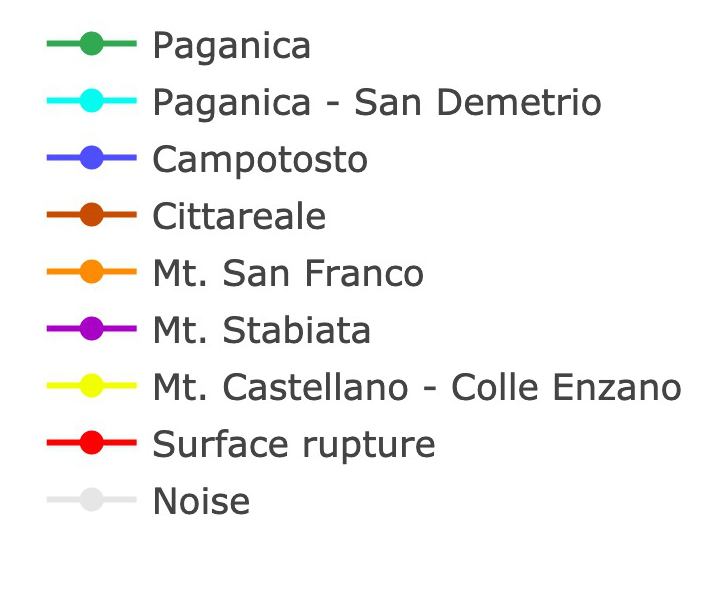

In [14]:
add_legend_plotly()

In [15]:
# Only worry about this cell if clustering labels have changed or if hypocenter dataset changed. 
# Store dbscan results to keep track of which labels correspond to which faults
if False: # This is only used so that we can decide which clusters (labels) belong to which fault. Re-running might mean we have to manually reselect the label of each fault. 
    import pickle
    class empty:
        pass
    hypo_faults = {'Paganica'      :db2.labels==0,
                    'Campotosto'    :db2.labels==1,
                    'Cittareale'    :db2.labels==7,
                    'Mt. San Franco':db2.labels==3,
                    'Noise'         :db2.labels==-1}
    pickle.dump(hypo_faults, open('stored_variables/preliminary_clusters','wb'))
    dbs = empty()
    [dbs.lon, dbs.lat, dbs.labels, dbs.mL, dbs.st1, dbs.st2, dbs.dp1, dbs.dp2, dbs.rk1, dbs.rk2] = [
     db2.lon, db2.lat, db2.labels, db2.mL, db2.st1, db2.st2, db2.dp1, db2.dp2, db2.rk1, db2.rk2]
    pickle.dump(dbs, open(variable_folder+'dbresults', 'wb'))

At this point of the workflow, only hypocenters belonging to the same
clusters, namely the same structures, are used in the next step and have
thus far only been flagged as "Paganica fault", "Campotosto fault",
"Cittareale fault" and so on (Figure 3). The hypocenters can now be
spatially interpolated to find a best fit 3D fault surface. We now focus
on the Paganica fault. Assuming the aftershocks of the fault cluster are
distributed in a damage zone approximately symmetrical with respect to
the fault surface (Valoroso et al., 2013), a least squares best-fit
surface will represent the mean location and thus closely resemble the
fault surface. We interpolated the hypocenters in the clustered faults
using splines. We choose splines because high-order polynomials tend to
suffer from unrealistic oscillations between interpolated data whereas
splines can converge to a solution using stable, low-order polynomials
(e.g. Fornberg and Zuev, 2007). The spline algorithm constructs a
piece-wise polynomial which is continuous and smooth. To apply splines,
we choose a coordinate system that is defined by a best fit plane to the
hypocenters of the DBSCAN clustered Paganica fault. The following
coordinate system is used: x~1~' faces along dip to the southeast, x~2~'
faces down dip, and x~3~' faces the hanging wall, normal to the plane.
We use 4th order bivariate B-splines (Prautzsch et al., 2002; Jones et
al., 2014) defined over the region 0 *\<*= *x*~1~ *\<*= 15*.*2 km and 0
*\<*= *x*~2~ *\<*= 34*.*0 km which contains all identified Paganica
fault hypocenters. We distribute throughout the plane a grid of nodes
with *dx*~1~ = 5668 m, and *dx*~2~ = 2544 m (Figure 4; Table 1)*.* In
order to have 4th order splines defined through the fault model,
exterior nodes must also be used; these are distributed at distances of
½ *dx*~1~ and ½ *dx*~2~ outside of our fault model (Figure 4). However,
the choice of exterior nodes is not important for our results. Finally,
the spline coefficients are inverted using least squares to minimize the
distance between the hypocenters and splines. The resulting splines
indicate the best fit fault surface model within the cluster of Paganica
fault earthquakes (Figure 4).

Figure 4. (a) 2D representation of the aftershocks that were part of the
Paganica fault cluster, and (b) the surface that interpolates them.
Position is shown on the best-fitting plane to the hypocenters. Color
represents distance in meters from the best fitting plane on which
spline knots were distributed. Selected fault traces are shown as their
projection onto the same plane. The viewing angle is such that the
viewer looks northeast and down.

In [16]:
# Create boolean showing which quakes are in L'Aquila cluster

# Then create boolean of those for which focal mechanisms are available
main_ind = np.argsort(db2.mL)[-1] # db2.mL == np.amax(db2.mL) # Can choose 3rd largest quake to look at Campotosto fault
pagan_lab = db2.labels[main_ind]
booLaqdb = db2.labels==pagan_lab

allPoints = hypoData(minMag=None)
allPoints.getHypocenters()

x2 = allPoints.x[booLaqdb]
y2 = allPoints.y[booLaqdb]
z2 = allPoints.z[booLaqdb]
st1 = allPoints.st1[booLaqdb]
st2 = allPoints.st2[booLaqdb]
dp1 = allPoints.dp1[booLaqdb]
dp2 = allPoints.dp2[booLaqdb]
focalbooLaqdb = (~( (allPoints.st1==0 ) * (allPoints.st2==0 ) * (allPoints.dp1==0 )
  * (allPoints.dp2==0 ) * (allPoints.rk1==0 ) * (allPoints.rk2==0 ) ))[booLaqdb]

In [17]:
splineNodesLine = 7 # changing from 7, 02/15/2020
cutPoints = True # convex hull. 02/15/2020

# note that surface is object for spline interpolation
surface = interp(x2, y2, z2,
               strikeHyp=st1, dipHyp=dp1, strike2Hyp=st2, dip2Hyp=dp2, focalBool=focalBool,
               eps=.1, minPlaneDist = None,exp=2,
               splineNodesStrike = splineNodesLine, splineNodesDip = splineNodesLine, 
               cutPoints = cutPoints, smooth = None)
# eps = .01, smooth = ??
surface.latCent, surface.lonCent = [db2.latCent, db2.lonCent] # Quick and dirty way of keeping track what lat and lon are at the center of our coordinate system. needed for plotting 3d fault traces. 2020.08.03

surface.focalAvailable=focalbooLaqdb

/Users/brennanbrunsvik/anaconda3/envs/fault_morph/lib/python3.7/site-packages/scipy/interpolate/fitpack2.py:1126: UserWarning:


The coefficients of the spline returned have been computed as the
minimal norm least-squares solution of a (numerically) rank deficient
system (deficiency=97). If deficiency is large, the results may be
inaccurate. Deficiency may strongly depend on the value of eps.



/Users/brennanbrunsvik/anaconda3/envs/fault_morph/lib/python3.7/site-packages/matplotlib/figure.py:98: MatplotlibDeprecationWarning:


Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.



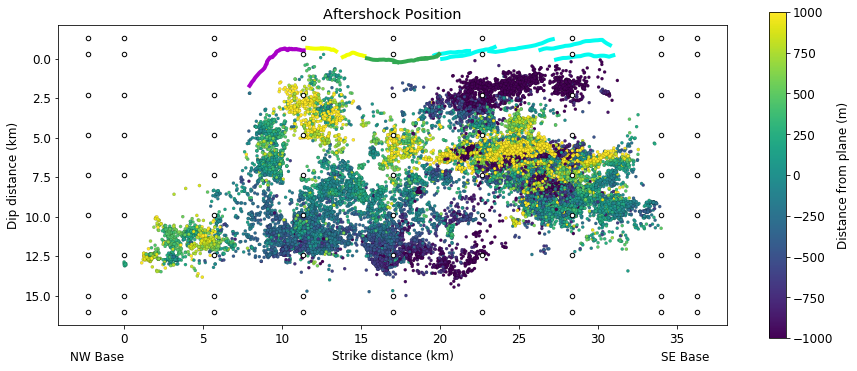

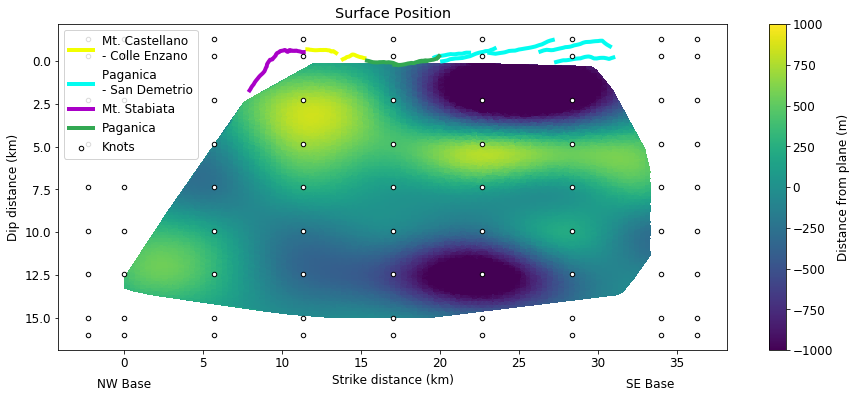

In [18]:
def add_traces_2d():
    try:
        thing = pickle.load(open('geo_data/traceinfo', 'rb'))
        fault_color_dict = thing['fault_color_dict']
        trace_to_label = thing['trace_to_label']

        mf, sr = load_fault_traces(mffile = 'geo_data/Mapped_Faults', srfile = 'geo_data/Surface_Ruptures')

        for ifault, fault in enumerate(mf):
            yf, xf = ChangeAxis(surface.latCent, surface.lonCent, fault['lats'], fault['lons'])
            faultS, faultD, __ = surface.forwardRotation(np.array([xf, yf, fault['elv']]).T)
        #     if np.amax(np.abs(__)) > 2000:
        #         continue
            fault_name = trace_to_label.get(fault['name'],'not present')
            color = fault_color_dict.get(fault_name, '#000000')
            if not fault_name in ['Paganica', 'Mt. Stabiata', 'Mt. Castellano - Colle Enzano', 'Paganica - San Demetrio']:
                continue
            faultS = (faultS - np.amin(surface.pS))/1000
            faultD = (faultD - np.amin(surface.pD))/1000
            if fault_name == 'Paganica':
                zorder = 12
            else:
                zorder = 11
            plt.plot(faultS, faultD, color = color, zorder = zorder, linewidth = 4)
    except:
        pass

surface.gridNodesStrike = 100
surface.gridNodesDip = 80
surface.splineInterp(cutPoints=True)
cbarmin = -1e3
cbarmax = 1e3

matplotlib.rcParams.update({'font.size': 12})
plt.figure(figsize=(15,6))

add_traces_2d()

nodes, noded = np.meshgrid(surface.knotS - np.amin(surface.pS), surface.knotD- np.amin(surface.pD)) 
nodes, noded = np.meshgrid(np.unique(surface.spline.get_knots()[0]) - np.amin(surface.pS), np.unique(surface.spline.get_knots()[1])- np.amin(surface.pD)) 
nodes *= 1/1000; noded *= 1/1000
plt.scatter(nodes, noded, s = 20, c = 'white', linewidth = 1, edgecolors='k', zorder = 12.5 )


xplot = (surface.pS-np.amin(surface.pS))/1000
yplot = (surface.pD-np.amin(surface.pD))/1000
#pS and pD are point (hypocenter) position in coordinate system of (strike, dip, normal)
plt.scatter(xplot, yplot, 
            c = surface.pN, vmin = cbarmin, vmax = cbarmax, 
            s = 10, linewidths = .1, edgecolor = 'k') 



plt.title('Aftershock Position')
plt.xlabel('Strike distance (km)')
plt.ylabel('Dip distance (km)')
cbar = plt.colorbar()
cbar.set_label('Distance from plane (m)')
plt.axes().set_aspect('equal')

shiftylabel = -3.5
plt.text(np.amin(xplot), np.amin(yplot)+shiftylabel, 'NW Base', 
         verticalalignment = 'top',
         horizontalalignment = 'right')
plt.text(np.amax(xplot), np.amin(yplot)+shiftylabel, 'SE Base', 
         verticalalignment = 'top',
         horizontalalignment = 'left')

ax = plt.gca()
ax.set(xlim = (-4.197219291376117, 38.20489992788256), ylim = (-1.8905988832845166, 17.15863323378141))
xlim = ax.get_xlim()
ylim = ax.get_ylim()

labels = ax.get_yticks().tolist() # Manually flip the yaxis so the origin is at top of fault, not bottom
labels.reverse()
ax.set_yticklabels(labels)
plt.savefig('figures/dist_scatter.jpg', dpi = 400)
plt.show()

plt.figure(figsize=(15,6))

add_traces_2d()


nodes, noded = np.meshgrid(surface.knotS - np.amin(surface.pS), surface.knotD- np.amin(surface.pD)) 
nodes, noded = np.meshgrid(np.unique(surface.spline.get_knots()[0]) - np.amin(surface.pS), np.unique(surface.spline.get_knots()[1])- np.amin(surface.pD)) 
nodes *= 1/1000; noded *= 1/1000
plt.scatter(nodes, noded, s = 20, c = 'white', linewidth = 1, edgecolors='k', zorder = 12.5, label = 'Knots')

ax = plt.gca()
ax.set(xlim = xlim, ylim = ylim)
xmin = 0
ymin = 0
xmax = (np.amax(surface.interpD) - np.amin(surface.interpD))/1000
ymax = (np.amax(surface.interpS) - np.amin(surface.interpS))/1000


xplot = (surface.interpS-np.amin(surface.interpS))/1000
yplot = (surface.interpD-np.amin(surface.interpD))/1000
zplot = surface.interpN
tri = plt.tripcolor(xplot, yplot, zplot)
tri.set_clim(cbarmin, cbarmax)
cbar = plt.colorbar()
cbar.set_label('Distance from plane (m)')
plt.title('Surface Position')
plt.xlabel('Strike distance (km)')
plt.ylabel('Dip distance (km)')

plt.text(ymin, xmin+shiftylabel, 'NW Base', 
         verticalalignment = 'top',
         horizontalalignment = 'center')
plt.text(ymax, xmin+shiftylabel, 'SE Base', 
         verticalalignment = 'top',
         horizontalalignment = 'center')

ax = plt.gca()
labels = ax.get_yticks().tolist() # Manually flip the yaxis so the origin is at top of fault, not bottom
labels.reverse()
ax.set_yticklabels(labels)

for ifault, faultname in enumerate(['Mt. Castellano \n- Colle Enzano',
                                    'Paganica \n- San Demetrio',
                                    'Mt. Stabiata',
                                    'Paganica',  
                                    ]):
    plt.plot([0,0], [0,0], linewidth = 4, label = faultname, color = fault_color_dict[faultname.replace('\n', '')])

plt.legend(loc = 2, framealpha=0.86).set_zorder(13)
plt.savefig('figures/dist_surf.jpg', dpi = 400)
plt.show()


Figure 5. Also available interactively online at
<https://bit.ly/3i1epZu>. Interpolated fault surface compared to
locations of hypocenters. Green represents the hypocenters that were
part of the cluster that contained the mainshock. Red shows all other
hypocenters. The perspectives are such that (a) views northeast, (b)
views northwest, (c) views southeast, and (d) views southwest. Looking
northwest (b), two challenges for the fault surface interpolation can be
seen. First, there are approximately three conjugate fault like trends
in the aftershocks which were clustered as the Paganica fault. Second,
the aftershocks and surface interpolation have low dip near the vertical
top of the south-east section of the Paganica fault. This could be a
separate and intersecting fault.

In [19]:
surface_coarse = copy.deepcopy(surface)
surface_coarse.gridNodesStrike = 25
surface_coarse.gridNodesDip = 20
surface_coarse.splineInterp(cutPoints=True)

if False or runAllFigures:
    fig2 = plot3dclusters(db2.x[booLaqdb], db2.y[booLaqdb], db2.z[booLaqdb], db2.labels[booLaqdb], # New plot style, 2020.08.14
               db2.latCent, db2.lonCent, color_option = 2, 
               interpX = surface_coarse.interpX, interpY = surface_coarse.interpY, interpZ = surface_coarse.interpZ, 
               interpS = surface_coarse.interpS, interpD = surface_coarse.interpD,
               faulttraces3d=True, pointSize=pointSize/2.5 , faultcolors = False)

    def save_3d(fig2, name):
        sc1 = 1.3
        sc2 = 1. 
        sc3 = .8
        sc4 = .5
        layouts = [
                  {'x':-.75*sc1, 'y':-.75*sc1, 'z':.5*sc1},
                  {'x':.65*sc2, 'y':-1*sc2, 'z':.13*sc2},
                  {'x':-1.3*sc3, 'y':.8*sc3, 'z':.6*sc3},
                  {'x':1.2*sc4, 'y':.8*sc4, 'z':2.2*sc4},
                  {'x':.1, 'y':-0.2, 'z':2},
                  ]

        for i in range(len(layouts)):
    #         if i != 3:
    #             continue
            layout = fig2.layout
            layout['scene']['camera']['eye'] = layouts[i]
            layout['scene']['camera']['center'] = {'x':.1, 'y':-.1, 'z':-.1}
            fig2.update({'layout':layout})
            fig2.write_image('figures/' + name + '_' + str(i+1) + '.jpg', scale = 7)
            im = PIL.Image.open('figures/' + name + '_' + str(i+1) + '.jpg')
        return im
    if False or savePlotlyFigures:
        im = save_3d(fig2, 'surf')
        fig2.write_html('figures/fig2.html')



3 Results 
=========

The final clusters, the results of DBSCAN, can be seen in Figure 3. Nine
clusters were recognized; among these, the Paganica, Campotosto, and
Cittareale faults are clearly represented. Of the 51339 events, 29367
were clustered as part of the Paganica fault, 9588 on the Campotosto
fault, and 5384 on the Cittareale fault. We also find a cluster between
the Paganica and Campotosto faults which appears to correspond to the
secondary Mt. San Franco fault according to the interpretation of
Lavecchia et al. (2012).

The general correspondence between these clusters and the potentially
associated geologically mapped fault traces can also be seen in Figure 3. Although the Paganica fault is our primary focus, and clustering
parameters were chosen for optimal performance on the Paganica cluster,
we describe other clusters briefly. The strike of the geologically
mapped Campotosto fault varies along its length, and the clustered
hypocenters of the Campotosto fault show a similar pattern in strike
along length, despite the clustered Campotosto hypocenters maintaining
depths of at least 4.5 km from the fault trace. The correspondence of
the Mt. San Franco fault and the mapped surface trace is less clear. For
example, the strike of the hypocenter distribution is \~N140°, while the
strike of the overall surface trace varies from similar values to
\~N100°. The hypocenters which were clustered as part of the Cittarreale
fault contain the M~w~ 3.9 event of that fault; however, mapped surface
traces of the Cittareale fault are distant from the hypocenters. Thus,
the mapped surface trace and cluster at depth are less similar. The
Cittareale cluster contains a group of faults, and is actually dominated
by NE dipping, antithetic faults.

The separation between major faults and more scattered and independent
aftershocks (referred to as noise and rejected by the DBSCAN algorithm)
appears successful. However, sets of faults antithetic to and
intersecting the Paganica cluster contained a high density of
aftershocks and these were not distinguishable from the Paganica fault
through clustering with our chosen parameters. In particular, we observe
3 faults at the south-east portion of and antithetic to the main
Paganica fault model which were too closely connected to the Paganica
fault to be distinguished (Figure 5). As reported in Ouillon et al.
(2008), allowing the number of clusters to increase separates
hypocenters which belong to the same fault, while having less clusters
tends to lump hypocenters of different faults together. In general, the
choice of clustering parameters involves a trade-off between capturing
the full seismogenic portion of a fault within a single cluster versus
separating out the minor fault splays (Figure S3). Another example of
this trade-off is illuminated where the fault which hosted the M~W~ 5.4
aftershock was considered mostly noise due its low aftershock density,
despite hosting a large earthquake.

The 3D Paganica fault surface that best fits the clustered hypocenters
can be seen in Figures 4 and 5. The modelled fault surface has a length
of \~34.0 km along strike at depth, and of \~20 km at the shallow
section of the fault. The northwest tip of the fault extends beneath
mapped surface ruptures including the Mt. Castellano-Colle Enzano
faults. It continues beneath the similarly striking portion of the Mt.
Stabiata fault and ends where the Mt. Stabiata fault transitions to
WNW-ESE striking. To the southeast, the fault surface extends slightly
beyond the Paganica fault surface ruptures, overlapping the San Demetrio
fault traces along strike. This is coherent with the radiography of the
seismological Paganica fault and its correspondences with mapped faults
as discussed in Chiaraluce et al. (2012) and Valoroso et al. (2013)
based on the same dataset. Finally, the fault surface extends about 15.4
km along dip.

Visually speaking, the surface is smooth and does not deviate greatly
from a plane. It shows curvature similar to other 3D fault models
generated with similar methods (Carena and Suppe, 2002; Kaven and
Pollard, 2013). The basic plane from which the surface is built (where
x~3~'=0), which indicates the average geometry of our Paganica fault
model, has a strike and dip of N143° and 42.6°, respectively. This is in
close agreement with (Lavecchia et al., 2012), whose 3D reconstruction
suggested a strike of \~N140° and dip of \~45°. A compilation of 9
previous L\'Aquila mainshock models shows values of strike between N133°
and N144° with an average of N137°, and values of dip between 47° and
56° with an average of 52° (Chiaraluce, 2012). The focal mechanism of
the mainshock shows a strike and dip of N135° and 55°. Measurements of
surface ruptures strike dominantly N130°-N140° (Boncio et al., 2010;
EMERGEO Working Group, 2010).

Approximately southeast of documented Paganica fault surface ruptures,
the model wavers as it interacts with the more complex distribution of
hypocenters. Here, moving upward, the dip abruptly flattens at about 3
km depth. This flattened portion of the fault model is likely
responsible for the lower than average dip of our Paganica fault model.
The shallow, flat dip portion of the fault model is likely not truly
associated with the Paganica fault. The incorporation of fault traces
during clustering could help to produce fault models which are more
consistent between hypocenter depths and the fault traces along the
entire length of faults (e.g. Castaldo, 2018), although automation of
such a procedure is outside the scope of this paper.

We note specifically two locations on the Paganica fault surface model
where issues in the interpolation might have arose; (i) near the
south-east edge of the fault where there are conjugate faults
intersecting the Paganica fault (Figure 5B), and (ii) at the north-west
edge of the fault where there were few aftershocks for interpolation
(Figures 4, 5A).

Regarding problem (i), because the clustering did not distinguish
between some conjugate planes that were closely connected to the
Paganica fault, the surface interpolation is slightly shifted by these
conjugate fault hypocenters (Figure 5B). Because the hypocenters were
widely distributed near the fault in the direction normal to the fault
(the aftershocks deviate from the 3D surface by \~600 m on average),
small variation in the fault surface does not conflict with the
hypocenter distribution. It is thus likely not a problem that the
surface is shifted slightly in this location.

Regarding problem (ii), although the splines were inverted with
regularly distributed knots, the hypocenters which were used to find the
knot parameters were distributed unevenly. Particularly at the upper
north-west of the fault, interpolation was done where few hypocenters
were available. The spline parameters in this location are thus
under-constrained. To address this problem, we applied a convex hull to
the Paganica fault's hypocenters. We only report the portion of our
fault model that is within this polygon.

To evaluate the accuracy of our 3D fault model, we compared its
orientation to the orientation of all 3422 available earthquake focal
mechanisms (\[Repository/DOI\]; Figure 6). This comparison is quantified
as the angle between the normal vectors at the fault surface model and
the normal vectors of the aftershock focal mechanisms. From the focal
mechanisms, both the fault planes and auxiliary planes are used. We
compare this angular mismatch result for our 3D fault model with a
planar model of Cirella et al. (2012). For both our 3D fault and for the
planar model, there is alignment at two primary peaks of 20° and 90°
which correspond to the fault and auxiliary planes of the focal
mechanisms, respectively (Figure 6b). Because earthquakes with greater
magnitude tend to involve larger rupture area and greater slip, we test
the fault surface to focal mechanism alignment weighted according to the
magnitude. While a weight of 32 ^M^ would be more consistent with the
moment and energy released from an earthquake, the results would be
completely dominated by the largest earthquake. We thus choose 10 ^M^ as
a weight to be consistent with the M~L~ ,M~b~, and M~S~ scales. The
weighted results are also shown in Figure 6b, where instead of plotting
a histogram of each angular mismatch, we plot a normalized histogram of
each angular mismatch weighted by 10^M^. Focal mechanism to fault plane
orientation agreement improves with this weighting scheme. Note that we
do not include the focal mechanism of the mainshock in the weighted
analysis because its high magnitude and weight would make it dominate
the orientation results, and the alignment of our fault model created
from aftershocks compared to the mainshock orientation is only of
secondary importance.

Figure 6. Anglular mismatch between the normal vectors of the
interpolated fault surface and the normal vectors of the available
earthquake focal mechanisms. (a) Angular mismatch compared to location
of hypocenters in the cluster that corresponds to the Paganica fault.
Location is distance along strike and along dip on the fault surface.
Only the best matching angle for each aftershock is used for (a). (b)
Histograms showing the number of focal planes with any given angular
mismatch (top) weighted by 10^M^ (bottom). We show both our 3D fault
model (left panels) and the planar model used in Cirella et al. (2012)
(right panels). Both focal planes of each focal mechanism were included
in (b). This results in alignment peaks near 90° that correspond with
the auxiliary planes of focal mechanisms. For the fault planes of the
focal mechanisms, alignment peaks are closer to 20°. Orientation match
is improved when using the magnitude as a weight.

In [20]:
# Make copy of old surface object so it doesn't get broken
# use it for comparing focal mechanisms. One for our surface + one for Cirella et al. (2012)

# Compare focal to a the planar fault plane of Cirella
planeVsSurface = copy.deepcopy(surface)
# input strike, dip, rake, get normals, use these for comparison
altSurfaceNormal, __=faultUnitVectors(np.array([2.32128791]), # Cirella used 133
                 np.array([0.9424778]), # Cirella used 54
                 np.array([0])
                )
planeVsSurface.compareFocal(altSurfaceNormal=altSurfaceNormal)
# planeVsSurface.compareFocal(altSurfaceNormal=surface.normalHat); print('Using my planar model now, not the published model')


# Compare focal to our 3D surface
unmodified = copy.deepcopy(surface)
unmodified.compareFocal()

# the dot products has been completed.

# create weights for Figure 5
mag = db2.mL[db2.labels==0][unmodified.focalAvailable]
weights = 10 ** mag 
bN = weights!=np.amax(weights)  # Boolean which excludes mainshock because it otherwise has too much weight

(1538, 3)
(1538, 3)


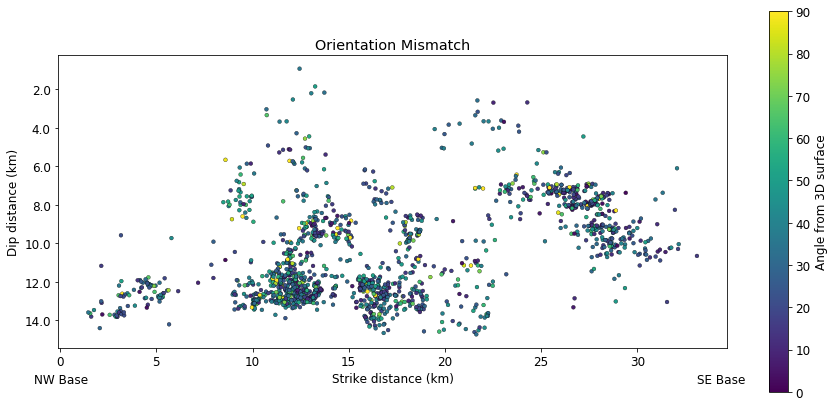

In [21]:
# Figure 6a
### ! the dip distance has flipped since previous submission: 02012020, as well as the distance being multiplied by -1
matplotlib.rcParams.update({'font.size': 12})
boo = unmodified.focalAvailable
plt.figure(figsize=(15,7))
plt.axes().set_aspect('equal')

x = (unmodified.pS[boo]-np.amin(unmodified.pS) )/1000
y = (unmodified.pD[boo]-np.amin(unmodified.pD) )/1000

plt.scatter(x, y, c=unmodified.thetaLeast*180/np.pi,
        vmin = 0, vmax = 90, linewidths=.3, edgecolors='k',
           s = 15)#3**mag)

shiftylabel = -2
plt.text(np.amin(x), np.amin(y)+shiftylabel, 'NW Base', 
         verticalalignment = 'top',
         horizontalalignment = 'right')
plt.text(np.amax(x), np.amin(y)+shiftylabel, 'SE Base', 
         verticalalignment = 'top',
         horizontalalignment = 'left')

cbar = plt.colorbar()
cbar.set_label('Angle from 3D surface')
plt.xlabel('Strike distance (km)')
plt.ylabel('Dip distance (km)')
plt.title('Orientation Mismatch')

ax = plt.gca()
labels = ax.get_yticks().tolist() # Manually flip the yaxis so the origin is at top of fault, not bottom
labels.reverse()
ax.set_yticklabels(labels)

plt.savefig('figures/orient_scatter.jpg', dpi = 400)

plt.show()

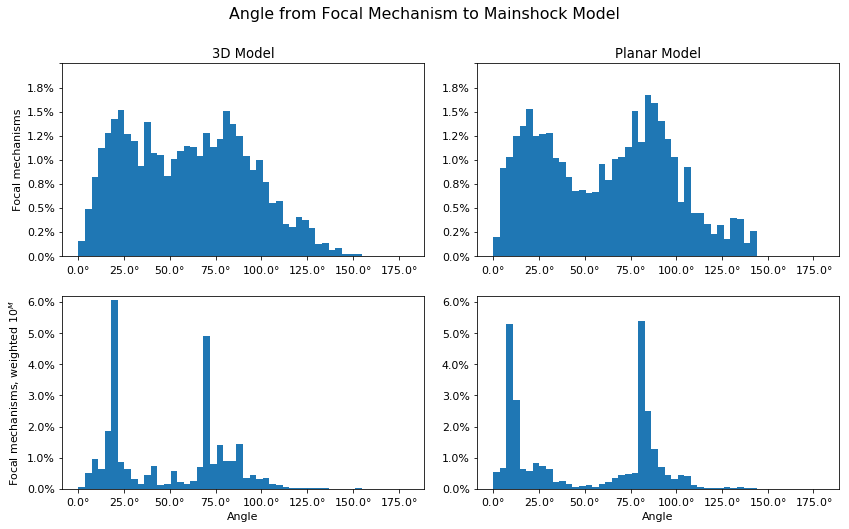

In [22]:
matplotlib.rcParams.update({'font.size': 11})
fig, axs = plt.subplots(2, 2, figsize=(12,7))

numbins = 50 

axs[0, 0].hist(
    np.array([unmodified.theta1[bN], unmodified.theta2[bN]]).ravel()*180/np.pi, 
         bins = numbins, range=(0, 180), density = True # 
        )
axs[0, 1].hist(np.array([planeVsSurface.theta1[bN], planeVsSurface.theta2[bN]]).ravel()*180/np.pi, 
         bins = numbins, range=(0, 180), density = True
        )
axs[1,0].hist(np.array([unmodified.theta1[bN], unmodified.theta2[bN]]).ravel()*180/np.pi, 
         bins = numbins, range=(0, 180), density=True,
         weights=np.array([weights[bN], weights[bN]]).ravel()
         )
axs[1,1].hist(np.array([planeVsSurface.theta1[bN], planeVsSurface.theta2[bN]]).ravel()*180/np.pi, 
         bins = numbins, range=(0, 180), density = True,
         weights=np.array([weights[bN], weights[bN]]).ravel()
        )

rangeTopFig = (0, .016)
rangeBotFit = (0, .062)
for i in range(2):
    axs[0, i].set_ylim(rangeTopFig)
for i in range(2):
    axs[1, i].set_ylim(rangeBotFit)

# for i in range(2): 
#     for j in range(2):
#         axs[i, j].tick_params(labelleft=False) 

for i in range(2): 
    for j in range(2):
        ax = axs[i, j]
        vals = ax.get_yticks()
        ax.set_yticklabels(['{:,.1%}'.format(x) for x in vals])

axs[0,0].set_title('3D Model', y = 1)
axs[0,1].set_title('Planar Model', y = 1)

for i in range(2):
    axs[1, i].set_xlabel('Angle')
    
axs[0, 0].set_ylabel('Focal mechanisms')
axs[1, 0].set_ylabel('Focal mechanisms, weighted $10^{M}$')

for i in range(axs.shape[0]):
    for j in range(axs.shape[1]):
        axs[i, j].set_xticklabels(['{:.1f}$\degree$'.format(x) for x in plt.gca().get_xticks()])

plt.tight_layout(pad = 1.3)
fig.suptitle("Angle from Focal Mechanism to Mainshock Model", fontsize="x-large", y = 1.05)
plt.savefig('figures/orient_hist.jpg', dpi = 400)
plt.show()


𝟒. Discussion and Conclusions
=============================

There is a need to develop and improve algorithms which can find the 3D
morphology of faults. The primary purpose here is to explore a new
algorithm to do so which is fast and objective and to investigate the
utility of machine learning for this purpose. We used successive
iterations of clustering to construct a quantitative model of the fault
segments associated with the L'Aquila seismic sequence. The approach,
based on a combination of spectral and DBSCAN clustering, provides
several advantages. The method can be applied in only a few seconds,
saving time in the case of analyzing a seismic sequence in real time,
while it is also objective in its determination of faults. In this way,
it provides advantages over the high-resolution options of manual fault
interpolation using many data types. It is advantageous over planar
clustering approaches in that it estimates the continuous first order
geometry of a fault zone. Curved faults, for instance the listric
Campotosto fault, can thus be represented with one cluster (Figure 3).
Using planar clustering, a curved fault would instead be represented
with several disconnected planes (e.g. Wang et al., 2013) which
complicates modelling the rupture of a mainshock along its entire
extent. An algorithm such as k-means, which clusters based on the
distribution of points around a clusters average point, would find
diffuse clouds of seismicity that are suitable for methods which are not
dependent on fault morphology (Weatherill and Burton, 2009). Our
Paganica fault model also has implications for the distribution of
aftershocks on fault splays, as well as the alignment of aftershocks to
the main faults. This is illuminated by comparing the aftershock
orientations and locations to the main fault model.

We tested the quality of the interpolated Paganica fault surface through
several approaches. One approach was to find how well the interpolated
fault surface matches the orientation of the earthquakes that it
interpolates (Figure 6). When comparing the match of aftershock
orientations to our 3D model and a 2D model (Cirella et al., 2012),
there does not appear to be an improvement moving from the planar model
to our 3D surface. This is probably due to the fact that the L'Aquila
mainshock ruptured on a relatively planar fault segment. Faults with
more curvature, such as the Campotosto fault, will likely show more
certain improvement by incorporating 3D morphology.

While ideally the aftershock orientations should have matched the 3D
fault surface model well, when comparing the mismatch with each
aftershock weighted equally, the aftershock orientations only mildly
agree with the planar as well as 3D fault models (Figure 6). However,
when we weighted this mismatch with the magnitude of aftershocks
(10^M^), the match between aftershocks and the 3D Paganica fault model
increases. This suggests that larger earthquakes are more closely
aligned with the surface and/or the focal mechanisms of smaller events
are less well identified. Another plausible reason could be that some
aftershocks may have been associated with conjugate faults instead of
the main fault surface (Figure 5b). There may be more unnoticed, smaller
conjugate faults as well.

However, the misalignment between the fault model and focal mechanisms
may have implications for the structure of the fault. Fault structures
can become very complex with damage zones involving various scales and
patterns (Peacock and Sanderson, 1991), and aftershock clusters tend to
occur at the most complex regions of a fault surface where damage zones
are the most extreme (Sibson 1989; Kim and Sanderson, 2008; Michele et
al., 2020). Not only damage zones, but also the complexity of fault
connectivity provides a means for aftershocks to rupture in directions
and locations not in agreement with the main fault surface. One model
for fault growth requires several smaller faults to link together, for
instance through the breaching of relay ramps, in order to form larger
faults (Childs et al., 2009). This results in complex rupture
geometries. Relay ramps allow for a fault to be connected by many
discontinuous faults at small and large scales. Relays have indeed been
observed on surface expressions of the Paganica fault (Roberts et al.,
2010). Faults can also be connected by extensional steps and
contractional steps (Kim, peacock, and Sanderson, 2004). The tips of a
fault can be particularly complex as well. Where fault displacement dies
out at the tips of faults, displacement tends to end in splays (Kim,
Peacock, and Sanderson, 2004). Splaying has been observed in the
Paganica fault geologically (Cinti et al., 2011) and seismically
(Chiaraluce et al., 2011). Given these issues, we are actually modelling
a complex fault zone as a single 3D surface. Thus, we expect
discontinuous sections of the fault zone to contain aftershocks which
align poorly to the main fault surface.

This approach could aid in seismic hazard assessment. Most models of
stress transfer that address aftershocks in the L'Aquila seismic
sequence rely on flat fault models (e.g. Serpelloni et al., 2012).
However, the 3D morphology of the mainshock as well as any recipient
faults will influence this stress and earthquake interaction,
influencing the development of earthquake sequences (Mildon et al.,
2016; Kaven and Pollard, 2013). Our 3D fault model can be used as the
basis for a 3D mainshock geometry, and the slip distribution can be
inverted using geodetic or waveform data (e.g. Kaven and Pollard, 2013;
Castaldo, 2018). This approach may illuminate important
foreshock-mainshock or mainshock-aftershock interactions that are
otherwise not clear.

This method can be applied to other seismic sequences. The L'Aquila
sequence itself is just one part of a larger extensional fault system
that has experienced several recent seismic sequences extending over
more than 150 km. This includes the 1979 Umbria sequence, the 1997
Colfiorito sequence, and the 2016 Amatrice/Visso/Norcia sequence. Other
locations where seismicity is thoroughly monitored, for instance
throughout California, could be good sites to apply this technique.
Applying this method to faults in developing seismic sequences could
help to illuminate locked zones where a region of a fault experiences
seismic quiescence but is surrounded by an active portion of the fault
(Avouac et al., 2015).

The Python code for this work is written in Jupyter Notebooks (Kluyver
et al., 2016; Morra, 2018) where the interactive code is embedded within
the manuscript. This is available in GitHub
(<https://github.com/brennanbrunsvik/Fault-morphology-clustering>) where
it can be ran through the cloud service Binder. Online interactive 3D
figures are available as well for the clustering and fault model
(<https://bit.ly/3i1epZu>).

**Acknowledgements**

We thank Raphael Gottardi, Carl Richter, and Martin Mai for helpful
comments and advice on writing. We thank Antonella Cirella, Olaf Zielke,
and Mehdi Nikkhoo for giving guidance on completing the code. We thank
two anonymous reviewers for helping to improve the manuscript. 3D
figures were made and provided interactively using plotly
(<https://plotly.com/>).


**References**
==============

Anderlini, L., Serpelloni, E., & Belardinelli, M. E. (2016). Creep and
locking of a low‐angle normal fault: Insights from the Altotiberina
fault in the Northern Apennines (Italy). Geophysical Research Letters,
43(9), 4321-4329.

Ansari, A., Firuzi, E., & Etemadsaeed, L. (2015). Delineation of Seismic
Sources in Probabilistic Seismic‐Hazard Analysis Using Fuzzy Cluster
Analysis and Monte Carlo Simulation. *Bulletin of the Seismological
Society of America*, *105*(4), 2174-2191.

Avouac, J. P. (2008). Dynamic processes in extensional and compressional
settings-mountain building: from earthquakes to geological deformation.
Treatise on geophysics, 6, 377-439.

Avouac, J. P., Meng, L., Wei, S., Wang, T., & Ampuero, J. P. (2015).
Lower edge of locked Main Himalayan Thrust unzipped by the 2015 Gorkha
earthquake. Nature Geoscience, 8(9), 708.

Barka, A. A., & Kadinsky‐Cade, K. (1988). Strike‐slip fault geometry in
Turkey and its influence on earthquake activity. *Tectonics*, *7*(3),
663-684.

Ben-Zion, Y., Peng, Z., Okaya, D., Seeber, L., Armbruster, J. G., Ozer,
N., \... & Aktar, M. (2003). A shallow fault-zone structure illuminated
by trapped waves in the Karadere--Duzce branch of the North Anatolian
Fault, western Turkey. Geophysical Journal International, 152(3),
699-717.

Bergen, K. J., Johnson, P. A., Maarten, V., & Beroza, G. C. (2019).
Machine learning for data-driven discovery in solid Earth geoscience.
Science, 363(6433), eaau0323.

Bletery, Q., Thomas, A. M., Rempel, A. W., Karlstrom, L., Sladen, A., &
De Barros, L. (2016). Mega-earthquakes rupture flat megathrusts.
Science, 354(6315), 1027-1031.

Boncio, P., Pizzi, A., Brozzetti, F., Pomposo, G., Lavecchia, G., Di
Naccio, D., & Ferrarini, F. (2010). Coseismic ground deformation of the
6 April 2009 L\'Aquila earthquake (central Italy, Mw6. 3). Geophysical
Research Letters, 37(6).

Carena, S., & Suppe, J. (2002). Three-dimensional imaging of active
structures using earthquake aftershocks: the Northridge thrust,
California. *Journal of Structural Geology*, *24*(4), 887-904.

Carena, S., Suppe, J., & Kao, H. (2002). Active detachment of Taiwan
illuminated by small earthquakes and its control of first-order
topography. *Geology*, *30*(10), 935-938.

Castaldo, R., De Nardis, R., DeNovellis, V., Ferrarini, F., Lanari, R.,
Lavecchia, G., \... & Tizzani, P. (2018). Coseismic Stress and Strain
Field Changes Investigation Through 3‐D Finite Element Modeling of
DInSAR and GPS Measurements and Geological/Seismological Data: The
L\'Aquila (Italy) 2009 Earthquake Case Study. Journal of Geophysical
Research: Solid Earth, 123(5), 4193-4222.

Chiaraluce, L. (2012). Unravelling the complexity of Apenninic
extensional fault systems: A review of the 2009 L\'Aquila earthquake
(Central Apennines, Italy). Journal of Structural Geology, 42, 2-18.

Chiaraluce, L., Valoroso, L., Piccinini, D., Di Stefano, R., & De Gori,
P. (2011). The anatomy of the 2009 L\'Aquila normal fault system
(central Italy) imaged by high resolution foreshock and aftershock
locations. Journal of Geophysical Research: Solid Earth, 116(B12).

Childs, C., Manzocchi, T., Walsh, J. J., Bonson, C. G., Nicol, A., &
Schöpfer, M. P. (2009). A geometric model of fault zone and fault rock
thickness variations. Journal of Structural Geology, 31(2), 117-127.

Cinti, F. R., Pantosti, D., De Martini, P. M., Pucci, S., Civico, R.,
Pierdominici, S., \... & Patera, A. (2011). Evidence for surface
faulting events along the Paganica fault prior to the 6 April 2009
L\'Aquila earthquake (central Italy). Journal of Geophysical Research:
Solid Earth, 116(B7).

Cirella, A., Piatanesi, A., Tinti, E., Chini, M., & Cocco, M. (2012).
Complexity of the rupture process during the 2009 L\'Aquila, Italy,
earthquake. Geophysical Journal International, 190(1), 607-621.

Custódio, S., Lima, V., Vales, D., Cesca, S., & Carrilho, F. (2016).
Imaging active faulting in a region of distributed deformation from the
joint clustering of focal mechanisms and hypocentres: Application to the
Azores--western Mediterranean region. Tectonophysics, 676, 70-89.

Di Luccio, F., Ventura, G., Di Giovambattista, R., Piscini, A., & Cinti,
F. R. (2010). Normal faults and thrusts reactivated by deep fluids: The
6 April 2009 Mw 6.3 L\'Aquila earthquake, central Italy. Journal of
Geophysical Research: Solid Earth, 115(B6).

EMERGEO Working Group. (2010). Evidence for surface rupture associated
with the Mw 6.3 L'Aquila earthquake sequence of April 2009 (central
Italy). Terra Nova, 22(1), 43-51.

Ester, M., Kriegel, H. P., Sander, J., & Xu, X. (1996). A density-based
algorithm for discovering clusters in large spatial databases with
noise. In Kdd (Vol. 96, No. 34, pp. 226-231).

Fischler, M. A., & Bolles, R. C. (1981). Random sample consensus: a
paradigm for model fitting with applications to image analysis and
automated cartography. Communications of the ACM, 24(6), 381-395.

Fornberg, B., & Zuev, J. (2007). The Runge phenomenon and spatially
variable shape parameters in RBF interpolation. Computers & Mathematics
with Applications, 54(3), 379-398.

Galvez, P., Ampuero, J. P., Dalguer, L. A., Somala, S. N., &
Nissen-Meyer, T. (2014). Dynamic earthquake rupture modelled with an
unstructured 3-D spectral element method applied to the 2011 M 9 Tohoku
earthquake. Geophysical Journal International, 198(2), 1222-1240.

Gudmundsson, Ó., & Sambridge, M. (1998). A regionalized upper mantle
(RUM) seismic model. Journal of Geophysical Research: Solid Earth,
103(B4), 7121-7136.

Hall, T. R., Nixon, C. W., Keir, D., Burton, P. W., & Ayele, A. (2018).
Earthquake Clustering and Energy Release of the African--Arabian Rift
System. Bulletin of the Seismological Society of America, 108(1),
155-162.

Hayes, G. P., Wald, D. J., & Johnson, R. L. (2012). Slab1. 0: A
three‐dimensional model of global subduction zone geometries. Journal of
Geophysical Research: Solid Earth, 117(B1).

Hubbard, J., Almeida, R., Foster, A., Sapkota, S. N., Bürgi, P., &
Tapponnier, P. (2016). Structural segmentation controlled the 2015 Mw
7.8 Gorkha earthquake rupture in Nepal. Geology, 44(8), 639-642.

Jones, E., Oliphant, T., & Peterson, P., and others (2014). {SciPy}:
open source scientific tools for {Python}.

Joshi, A., & Kaur, R. (2013). A review: Comparative study of various
clustering techniques in data mining. International Journal of Advanced
Research in Computer Science and Software Engineering, 3(3).

Kaven, J. O., & Pollard, D. D. (2013). Geometry of crustal faults:
Identification from seismicity and implications for slip and stress
transfer models. *Journal of Geophysical Research: Solid
Earth*, *118*(9), 5058-5070.

Kim, Y. S., Peacock, D. C., & Sanderson, D. J. (2004). Fault damage
zones. Journal of structural geology, 26(3), 503-517.

Kim, Y. S., & Sanderson, D. J. (2008). Earthquake and fault propagation,
displacement and damage zones. Structural Geology: New Research, 1,
99-117.

Kluyver, T., Ragan-Kelley, B., Pérez, F., Granger, B. E., Bussonnier,
M., Frederic, J., \... & Ivanov, P. (2016, May). Jupyter Notebooks-a
publishing format for reproducible computational workflows. In ELPUB
(pp. 87-90).

Kong, Q., Trugman, D. T., Ross, Z. E., Bianco, M. J., Meade, B. J., &
Gerstoft, P. (2019). Machine Learning in Seismology: Turning Data into
Insights. Seismological Research Letters.

Landry, W., & Barbot, S. (2018). Fast, accurate solutions for
curvilinear earthquake faults and anelastic strain. arXiv preprint
arXiv:1802.08931.

Latorre, D., Mirabella, F., Chiaraluce, L., Trippetta, F., & Lomax, A.
(2016). Assessment of earthquake locations in 3‐D deterministic velocity
models: A case study from the Altotiberina Near Fault Observatory
(Italy). *Journal of Geophysical Research: Solid Earth*, *121*(11),
8113-8135.

Lavecchia, G., Adinolfi, G. M., de Nardis, R., Ferrarini, F., Cirillo,
D., Brozzetti, F., \... & Zollo, A. (2017). Multidisciplinary inferences
on a newly recognized active east‐dipping extensional system in Central
Italy. Terra Nova, 29(1), 77-89.

Lavecchia, G., Castaldo, R., De Nardis, R., De Novellis, V., Ferrarini,
F., Pepe, S., \... & Boncio, P. (2016). Ground deformation and source
geometry of the 24 August 2016 Amatrice earthquake (Central Italy)
investigated through analytical and numerical modeling of DInSAR
measurements and structural‐geological data. Geophysical Research
Letters, 43(24), 12-389.

Lavecchia, G., Ferrarini, F., Brozzetti, F., De Nardis, R., Boncio, P.,
& Chiaraluce, L. (2012). From surface geology to aftershock analysis:
Constraints on the geometry of the L'Aquila 2009 seismogenic fault
system. *Italian Journal of Geosciences*, *131*(3), 330-347.

Lohr, T., Krawczyk, C. M., Oncken, O., & Tanner, D. C. (2008). Evolution
of a fault surface from 3D attribute analysis and displacement
measurements. Journal of Structural Geology, 30(6), 690-700.

Lucente, F. P., De Gori, P., Margheriti, L., Piccinini, D., Di Bona, M.,
Chiarabba, C., & Piana Agostinetti, N. (2010). Temporal variation of
seismic velocity and anisotropy before the 2009 MW 6.3 L\'Aquila
earthquake, Italy. Geology, 38(11), 1015-1018.

Malagnini, L., Lucente, F. P., De Gori, P., Akinci, A., & Munafo, I.
(2012). Control of pore fluid pressure diffusion on fault failure mode:
Insights from the 2009 L\'Aquila seismic sequence. Journal of
Geophysical Research: Solid Earth, 117(B5).Mildon, Z. K., Toda, S.,
Faure Walker, J. P., & Roberts, G. P. (2016). Evaluating models of
Coulomb stress transfer: Is variable fault geometry important?
Geophysical Research Letters, 43(24), 12-407.

Mancini, S., Segou, M., Werner, M. J., & Cattania, C. (2019). Improving
physics‐based aftershock forecasts during the 2016--2017 Central Italy
Earthquake Cascade. Journal of Geophysical Research: Solid Earth,
124(8), 8626-8643.

Michele, M., Chiaraluce, L., Di Stefano, R., & Waldhauser, F. (2020).
Fine‐Scale Structure of the 2016--2017 Central Italy Seismic Sequence
From Data Recorded at the Italian National Network. Journal of
Geophysical Research: Solid Earth, 125(4), e2019JB018440.

Miller, S. A., Collettini, C., Chiaraluce, L., Cocco, M., Barchi, M., &
Kaus, B. J. (2004). Aftershocks driven by a high-pressure CO2 source at
depth. Nature, 427(6976), 724.

Mirabella, F., Brozzetti, F., Lupattelli, A., & Barchi, M. R. (2011).
Tectonic evolution of a low‐angle extensional fault system from restored
cross‐sections in the Northern Apennines (Italy). Tectonics, 30(6).

Moore, G. F., Bangs, N. L., Taira, A., Kuramoto, S., Pangborn, E., &
Tobin, H. J. (2007). Three-dimensional splay fault geometry and
implications for tsunami generation. *Science*, *318*(5853), 1128-1131.

Morra, G. (2018). Pythonic Geodynamics*. Lecture Notes in Earth System
Sciences*.

Mousavi, S. M., & Beroza, G. C. (2019). A Machine‐Learning Approach for
Earthquake Magnitude Estimation. *Geophysical Research Letters.*

Novianti, P., Setyorini, D., & Rafflesia, U. (2017). K-Means cluster
analysis in earthquake epicenter clustering. International Journal of
Advances in Intelligent Informatics, 3(2), 81-89.

Omran, M. G., Engelbrecht, A. P., & Salman, A. (2007). An overview of
clustering methods. Intelligent Data Analysis, 11(6), 583-605.

Ouillon, G., Ducorbier, C., & Sornette, D. (2008). Automatic
reconstruction of fault networks from seismicity catalogs:
Three‐dimensional optimal anisotropic dynamic clustering. *Journal of
Geophysical Research: Solid Earth*, *113*(B1).

Ouillon, G., & Sornette, D. (2011). Segmentation of fault networks
determined from spatial clustering of earthquakes. *Journal of
Geophysical Research: Solid Earth*, *116*(B2).

Peacock, D. C. P., & Sanderson, D. J. (1991). Displacements, segment
linkage and relay ramps in normal fault zones. Journal of Structural
Geology, 13(6), 721-733.

Pedregosa, F., Varoquaux, G., Gramfort, A., Michel, V., Thirion, B.,
Grisel, O., \... & Vanderplas, J. (2011). Scikit-learn: Machine learning
in Python. Journal of machine learning research, 12(Oct), 2825-2830.

Pelties, C., Puente, J., Ampuero, J. P., Brietzke, G. B., & Käser, M.
(2012). Three‐dimensional dynamic rupture simulation with a high‐order
discontinuous Galerkin method on unstructured tetrahedral meshes.
Journal of Geophysical Research: Solid Earth, 117(B2).

Peng, Z., Ben-Zion, Y., Michael, A. J., & Zhu, L. (2003). Quantitative
analysis of seismic fault zone waves in the rupture zone of the 1992
Landers, California, earthquake: evidence for a shallow trapping
structure. *Geophysical Journal International*, *155*(3), 1021-1041.

Prautzsch, H., Boehm, W., & Paluszny, M. (2002). *Bézier and B-spline
techniques*. Springer Science & Business Media.

Qiu, Q., Hill, E. M., Barbot, S., Hubbard, J., Feng, W., Lindsey, E. O.,
\... & Tapponnier, P. (2016). The mechanism of partial rupture of a
locked megathrust: The role of fault morphology. Geology, 44(10),
875-878.

Ragon, T., Sladen, A., & Simons, M. (2018). Accounting for uncertain
fault geometry in earthquake source inversions--I: theory and simplified
application. Geophysical Journal International, 214(2), 1174-1190.

Rietbrock, A., Tiberi, C., Scherbaum, F., & Lyon‐Caen, H. (1996).
Seismic slip on a low angle normal fault in the Gulf of Corinth:
Evidence from high‐resolution cluster analysis of microearthquakes.
Geophysical Research Letters, 23(14), 1817-1820.

Roberts, G. P., Raithatha, B., Sileo, G., Pizzi, A., Pucci, S., Walker,
J. F., \... & Guerrieri, L. (2010). Shallow subsurface structure of the
2009 April 6 M w 6.3 L\'Aquila earthquake surface rupture at Paganica,
investigated with ground-penetrating radar. Geophysical Journal
International, 183(2), 774-790.

Rouet‐Leduc, B., Hulbert, C., Lubbers, N., Barros, K., Humphreys, C. J.,
& Johnson, P. A. (2017). Machine learning predicts laboratory
earthquakes. *Geophysical Research Letters*, 44(18), 9276-9282.

Røe, P., Georgsen, F., & Abrahamsen, P. (2014). An uncertainty model for
fault shape and location. Mathematical Geosciences, 46(8), 957-969.

Serpelloni, E., Anderlini, L., & Belardinelli, M. E. (2012). Fault
geometry, coseismic-slip distribution and Coulomb stress change
associated with the 2009 April 6, M W 6.3, L′ Aquila earthquake from
inversion of GPS displacements. Geophysical Journal International,
188(2), 473-489.

Schubert, E., Sander, J., Ester, M., Kriegel, H. P., & Xu, X. (2017).
DBSCAN revisited, revisited: why and how you should (still) use DBSCAN.
ACM Transactions on Database Systems (TODS), 42(3), 1-21.

Sibson, R. H. (1989). Earthquake faulting as a structural process.
Journal of Structural Geology, 11(1-2), 1-14.

Scitovski, S. (2018). A density-based clustering algorithm for
earthquake zoning. Computers & Geosciences, 110, 90-95.

Skoumal, R. J., Kaven, J. O., & Walter, J. I. (2019). Characterizing
seismogenic fault structures in Oklahoma using a relocated
template‐matched catalog. Seismological Research Letters, 90(4),
1535-1543.

Syracuse, E. M., & Abers, G. A. (2006). Global compilation of variations
in slab depth beneath arc volcanoes and implications. Geochemistry,
Geophysics, Geosystems, 7(5).

Trugman, D. T., & Shearer, P. M. (2017). GrowClust: A hierarchical
clustering algorithm for relative earthquake relocation, with
application to the Spanish Springs and Sheldon, Nevada, earthquake
sequences. Seismological Research Letters, 88(2A), 379-391.

Tung, S., & Masterlark, T. (2018). Resolving Source Geometry of the 24
August 2016 Amatrice, Central Italy, Earthquake from InSAR Data and 3D
Finite‐Element ModelingResolving Source Geometry of the 2016 Amatrice
Earthquake from InSAR Data and 3D FEMs. Bulletin of the Seismological
Society of America, 108(2), 553-572.

Valoroso, L., Chiaraluce, L., Piccinini, D., Di Stefano, R., Schaff, D.,
& Waldhauser, F. (2013). Radiography of a normal fault system by 64,000
high‐precision earthquake locations: The 2009 L\'Aquila (central Italy)
case study. Journal of Geophysical Research: Solid Earth, 118(3),
1156-1176.

Verdecchia, A., Pace, B., Visini, F., Scotti, O., Peruzza, L., &
Benedetti, L. (2018). The role of viscoelastic stress transfer in
long‐term earthquake cascades: Insights after the central Italy
2016--2017 seismic sequence. *Tectonics*, *37*(10), 3411-3428.

Von Luxburg, U. (2007). A tutorial on spectral clustering. Statistics
and computing, 17(4), 395-416.

Waldhauser, F., & Ellsworth, W. L. (2000). A double-difference
earthquake location algorithm: Method and application to the northern
Hayward fault, California. Bulletin of the Seismological Society of
America, 90(6), 1353-1368.

Wang, Y., Ouillon, G., Woessner, J., Sornette, D., & Husen, S. (2013).
Automatic reconstruction of fault networks from seismicity catalogs
including location uncertainty. *Journal of Geophysical Research: Solid
Earth*, *118*(11), 5956-5975.

Weatherill, G., & Burton, P. W. (2009). Delineation of shallow seismic
source zones using K-means cluster analysis, with application to the
Aegean region. *Geophysical Journal International*, *176*(2), 565-588.

Zhang, Z., Zhang, W., & Chen, X. (2014). Three-dimensional curved grid
finite-difference modelling for non-planar rupture dynamics. Geophysical
Journal International, 199(2), 860-879.

Zhu, W., & Beroza, G. C. (2019). PhaseNet: a deep-neural-network-based
seismic arrival-time picking method. *Geophysical Journal
International*, 216(1), 261-273.

Zielke, O., Galis, M., & Mai, P. M. (2017). Fault roughness and strength
heterogeneity control earthquake size and stress drop. Geophysical
Research Letters, 44(2), 777-783.